<a href="https://colab.research.google.com/github/SubhashShanmuka/Supply-Chain-projects/blob/main/Japan_Electricity_market.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Japan Electricity Market | Imbalance Prices

A comprehensive electricity demand & supply analysis based on the Electricity dataset from 2022-Present

Dataset: [Kaggle Link](https://www.kaggle.com/datasets/mitsuyasuhoshino/japan-imbalance-prices/data)

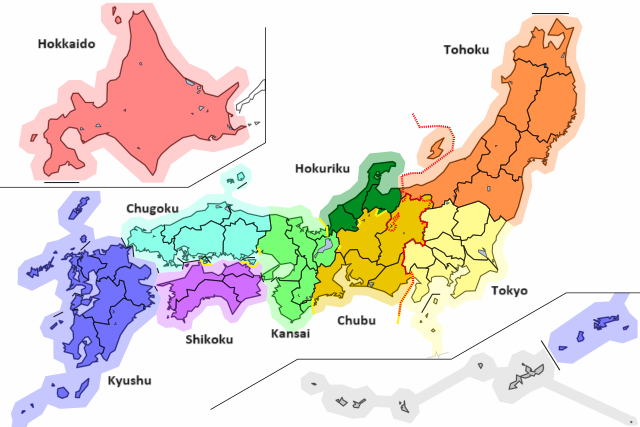

In [5]:
import pandas as pd
import matplotlib.pyplot as plt


# Load the dataset
file_path = 'Japan_ImbalancePrice.csv'
df = pd.read_csv(file_path)

# Display the first few rows of the dataset
df.head()


,date,time code,Hokkaido_ibprice,Tohoku_ibprice,Tokyo_ibprice,Chubu_ibprice,Hokuriku_ibprice,Kansai_ibprice,Chugoku_ibprice,Shikoku_ibprice,Kyushu_ibprice
0,2022/03/01,1.0,16.44,16.44,16.44,17.62,17.62,17.62,17.62,17.62,12.04
1,2022/03/01,2.0,12.04,12.04,12.04,12.04,12.04,12.04,12.04,12.04,12.04
2,2022/03/01,3.0,16.46,16.46,16.46,16.46,16.46,16.46,16.46,16.46,16.46
3,2022/03/01,4.0,16.54,16.54,16.54,16.54,16.54,16.54,16.54,16.54,16.54
4,2022/03/01,5.0,12.87,16.44,16.44,16.44,16.44,16.44,16.44,16.44,16.44


Statistical analysis

In [15]:
summary_stats = df[regions].describe().T
summary_stats['median'] = df[regions].median()

summary_stats

,count,mean,std,min,25%,50%,75%,max,median
Hokkaido_ibprice,43937.0,18.151514,12.548966,0.0,9.29,15.12,23.72,200.00,15.12
Tohoku_ibprice,43937.0,17.203397,11.674079,0.0,9.85,13.65,22.14,162.80,13.65
Tokyo_ibprice,43937.0,18.535829,12.791615,0.0,10.69,14.97,23.41,200.00,14.97
Chubu_ibprice,43937.0,16.289905,10.304769,0.0,9.97,13.72,21.08,114.22,13.72
Hokuriku_ibprice,43937.0,15.299594,9.940221,0.0,9.26,12.83,20.09,114.22,12.83
Kansai_ibprice,43937.0,15.223533,10.007482,0.0,9.17,12.70,20.04,114.22,12.70
Chugoku_ibprice,43937.0,15.025903,9.862517,0.0,9.11,12.58,19.66,114.22,12.58
Shikoku_ibprice,43937.0,15.029997,9.861008,0.0,9.05,12.62,19.77,114.22,12.62
Kyushu_ibprice,43937.0,12.308176,7.439541,0.0,8.56,11.39,15.51,114.22,11.39


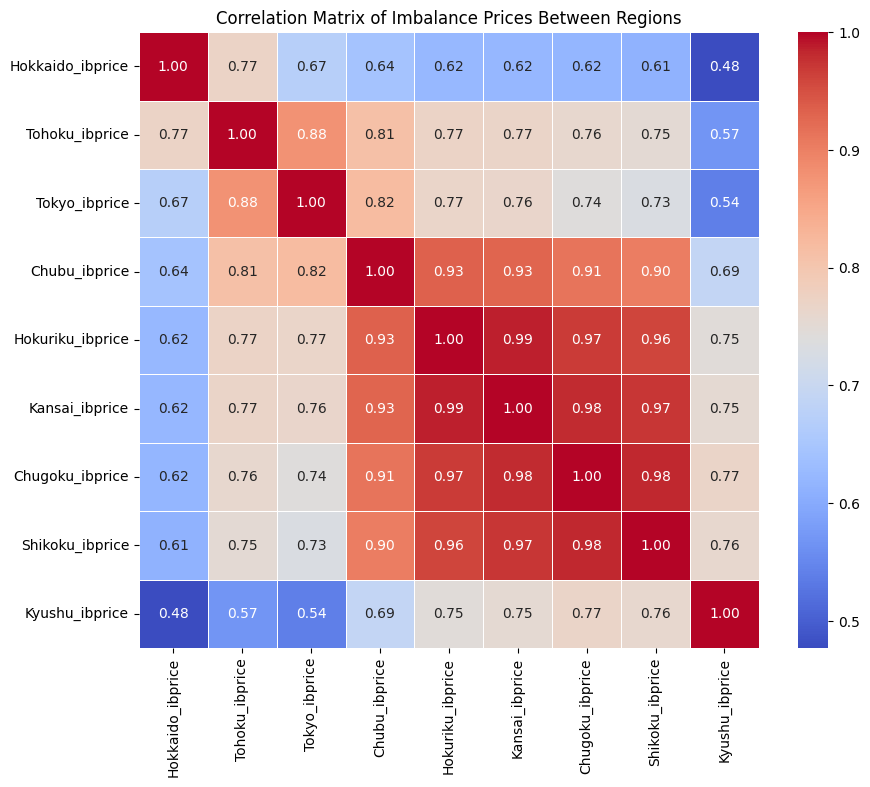

In [12]:
import seaborn as sns
import matplotlib.pyplot as plt

# Correlation matrix
correlation_matrix = df[regions].corr()

# Plot the correlation matrix using seaborn
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Matrix of Imbalance Prices Between Regions')
plt.show()

# **Time Series analysis**

In [7]:
import plotly.graph_objs as go
import pandas as pd

# Set the date column as datetime format
df['date'] = pd.to_datetime(df['date'])

# Create a figure
fig = go.Figure()

# Add a trace for each region
regions = df.columns[2:]  # All columns except 'date' and 'time code'

for region in regions:
    fig.add_trace(go.Scatter(x=df['date'], y=df[region], mode='lines', name=region))

# Update layout
fig.update_layout(
    title='Time Series of Imbalance Prices for Each Region',
    xaxis_title='Date',
    yaxis_title='Imbalance Price (Yen/kWh)',
    legend_title='Regions',
    hovermode='x unified',
    template='plotly'
)

# Add interactive legend and sliders
fig.update_layout(
    updatemenus=[
        {
            'buttons': [
                {'label': region, 'method': 'update',
                 'args': [{'visible': [region == col for col in regions]}]}
                for region in regions
            ],
            'direction': 'down',
            'showactive': True
        }
    ]
)

# Show the plot
fig.show()


/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [10]:
import plotly.graph_objs as go
import pandas as pd

# Calculate the 7-day rolling average for each region
df_rolling = df.copy()
for region in regions:
    df_rolling[region + '_rolling'] = df_rolling[region].rolling(window=7).mean()

# Create a Plotly figure
fig = go.Figure()

# Add a trace for each region's rolling average
for region in regions:
    fig.add_trace(go.Scatter(
        x=df_rolling['date'],
        y=df_rolling[region + '_rolling'],
        mode='lines',
        name=region + ' (Rolling Avg)'
    ))

# Update the layout of the figure
fig.update_layout(
    title='Weekly Rolling Average of Imbalance Prices for Each Region',
    xaxis_title='Date',
    yaxis_title='Imbalance Price (Yen/kWh)',
    legend_title='Regions',
    hovermode='x unified',
    template='plotly',
    updatemenus=[
        {
            'buttons': [
                {'label': 'Select All', 'method': 'update',
                 'args': [{'visible': [True] * len(regions)}]},
                {'label': 'Deselect All', 'method': 'update',
                 'args': [{'visible': [False] * len(regions)}]},
            ],
            'direction': 'left',
            'showactive': True,
            'x': 0.1,
            'xanchor': 'left',
            'y': 1.15,
            'yanchor': 'top',
            'type': 'buttons'
        }
    ]
)

# Show the interactive plot
fig.show()



/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

